In [66]:
from types import SimpleNamespace
from functools import partial
import numpy as np
import scipy
from matplotlib import pyplot
from open_atmos_jupyter_utils import show_plot
from scipy import interpolate

In [67]:
from PySDM.initialisation import spectra
from PySDM.physics import si

In [ ]:
PARAMS_PHYS = SimpleNamespace(
    # n0=2**23,
    dv_m3 = 2**12 * si.meter**3 ,  # volume of a gridbox
    # x0_kg=1.192e-13,
    # b_per_s = 1500,
)



mode1 = spectra.Lognormal(
            norm_factor=90 / si.centimetre**3,
            m_mode=0.03 * si.micrometre,
            s_geom=1.28,
        )
mode2 = spectra.Lognormal(
            norm_factor=15 / si.centimetre**3,
            m_mode=0.14 * si.micrometre,
            s_geom=1.75,
        )
radii_spectrum = spectra.Sum((mode1, mode2))
PARAMS_PHYS.dist = radii_spectrum #scipy.stats.expon(loc=0, scale=PARAMS_PHYS.x0_kg)

PARAMS_PHYS.norm = radii_spectrum.norm_factor * PARAMS_PHYS.dv_m3

PARAMS_COMP = SimpleNamespace(
    n_part = 2**12,
    # t_max_s = 3600,
    # n_step = 1800,
)
# PARAMS_COMP.dt_s = PARAMS_COMP.t_max_s / PARAMS_COMP.n_step

PARAMS_BINS = SimpleNamespace(
    min_x = np.exp(2)*si.nm,
    max_x = np.exp(9)*si.nm,
    count = 70
)

RNG = np.random.default_rng(seed=44)

In [69]:
def alpha_sampling(alpha, x_prime,params_phys, params_comp, u01):
    Fb1 = params_phys.dist.cdf
    delta_x = (x_prime[-1] - x_prime[0])
    def Fb2_inv(y):
        return delta_x * y
    
    sd_cdf = Fb1(x_prime)
    x_sd_cdf = (1-alpha) * x_prime + alpha * Fb2_inv(sd_cdf)
    inv_cdf = interpolate.interp1d(sd_cdf,x_sd_cdf)
    cdf_interp = interpolate.interp1d(x_sd_cdf,sd_cdf)
    

    ## this part looks like __sample in spectra.py
    percent_values = np.linspace(.000001, .99999, num=2 * params_comp.n_part + 1)

    vol_array = inv_cdf(percent_values)
    sd_vol_x = vol_array[1:-1:2]
    cdf = params_phys.dist.cdf(vol_array[0::2]) 
    y_float = (cdf[1:] - cdf[0:-1]) * params_phys.norm

    sd_pdf = np.diff(cdf_interp(vol_array[0::2])) /(np.diff(vol_array[0::2])/(vol_array[-1] - vol_array[0]))
    
    return {'x':sd_vol_x,
            'y':y_float,
            'sd_pdf':sd_pdf/sum(sd_pdf),
            }


In [70]:
def sample(*, params_comp, params_phys, rng):
    """ randomly samples a particle population using constant-multiplicity,
    uniform-mass and uniform-log-mass schemes and returns a dictionary
    of three simulation state, each composed of 'mass' and 'mult' arrays """
    u01 = rng.uniform(0, 1, size=params_comp.n_part)
    uniform_sampling_range = [params_phys.dist.percentiles(q) for q in (.000001, .99999)]
    x_uniform_linx = np.sort(
        uniform_sampling_range[0]
        + u01 * (uniform_sampling_range[1] - uniform_sampling_range[0])
    )

    x_prime = np.linspace(uniform_sampling_range[0], uniform_sampling_range[1], (params_comp.n_part + 1))
    alph_sampling = partial(
        alpha_sampling,
        x_prime=x_prime,
        params_phys=params_phys,
        params_comp=params_comp,
        u01=u01,
    )
    
    return {
        k: {
            'mass': v['x'],
            'mult': np.round(v['y']).astype(int),
            'sd_pdf': v['sd_pdf'],
        }
        for k,v in
        {
            # 'sampling: uniform random in x': {
            #     'x': x_uniform_linx,
            #     'y': params_phys.dist.pdf(x_uniform_linx) \
            #       * (uniform_sampling_range[1] - uniform_sampling_range[0]) \
            #       / params_comp.n_part * params_phys.norm,
            #     'sd_pdf': np.full(shape=params_comp.n_part, fill_value=np.nan),
            # },
            'sampling: alpha = 1': alph_sampling(1),
            'sampling: alpha = 0.9': alph_sampling(0.9),
            'sampling: alpha = 0.8': alph_sampling(0.8),
            'sampling: alpha = 0.7': alph_sampling(0.7),
            'sampling: alpha = 0.6': alph_sampling(0.6),
            'sampling: alpha = 0.5': alph_sampling(0.5),
            'sampling: alpha = 0.4': alph_sampling(0.4),
            'sampling: alpha = 0.3': alph_sampling(0.3),
            'sampling: alpha = 0.2': alph_sampling(0.2),
            'sampling: alpha = 0.1': alph_sampling(0.1),
            'sampling: alpha = 0': alph_sampling(0),

            # 'sampling: constant multiplicity': {
            #     'x': params_phys.dist.percentiles(u01),
            #     'y': np.full(shape=params_comp.n_part, fill_value=1 / params_comp.n_part)* params_phys.norm,
            #     'sd_pdf': np.full(shape=params_comp.n_part, fill_value=np.nan),           
            # }
        }.items()
    }

PARTICLES = sample(params_phys=PARAMS_PHYS, params_comp=PARAMS_COMP, rng=RNG)

In [71]:
def x_of_mass(mass):
    """ defines the plot x coordinate as a funciton of particle mass """
    return (mass)

def mass_of_x(coord):
    """ computes mass back from the plot x coordinate """
    return coord

In [72]:
from os import kill
def plot(*, particles, params_phys, params_comp, params_bins, rng, time=0):
    """ plots the particle state as both a histogram as well as population scatter plot
    (with random coordinates shuffled for the purpose of plotting) """
    fig, axs = pyplot.subplot_mosaic(
        [['number'],['mass'],[''],*[[k] for k in particles]],
        figsize=(10, 12),
        gridspec_kw={'height_ratios': [1.5,1.5,0.2]+[.6]*len(particles)},
        sharex=True,
        # tight_layout=True,
        layout='constrained'
    )
    scale = params_phys.norm / params_comp.n_part
    for ik, k in enumerate(particles):
        lin_x, d_x = np.linspace(params_bins.min_x, params_bins.max_x, 256, retstep=True)
        x_mean = lin_x[:-1] + d_x / 2
        m_mean = mass_of_x(x_mean)
        for hist in ('mass', 'number'):
            #for kwargs in ({}, {'histtype': 'step', 'fill':False}):
            axs[hist].hist(
                    x=x_of_mass(particles[k]['mass']),
                    weights=particles[k]['mult'] * (particles[k]['mass'] if hist=='mass' else 1),
                    bins=params_bins.count,
                    linewidth=1.5,
                    range=(params_bins.min_x, params_bins.max_x),
                    label=k,
                    alpha=.666,
                    density=True,
                    fill=True
                )
            axs[hist].legend(loc='upper right')
            axs[hist].set(
                ylabel=f'{hist} density',
                title=(f'binned {hist} density'),
                xlim=(params_bins.min_x, params_bins.max_x),
                yticks = [],
                xscale='log'
            )
        lastscatter = axs[k].scatter(
            x_of_mass(particles[k]['mass']),
            rng.uniform(0,1, params_comp.n_part),
            s= .25 + 2 * particles[k]['mult'] / scale,
            c=particles[k]['mult'],
            # label=f'{k}',
            alpha=.666,
            clim=(
                min(*[min(particles[kk]['mult']) for kk in particles]),
                max(*[max(particles[kk]['mult']) for kk in particles]),
            )
        )

        axs[k].set_yticks([])
        axs[k].set_xticks([])
        axs[k].set_ylim(0,1)
        axs[k].set_ylabel("aux attr")
        axs[k].set_title(k)
        axs[k].set_xscale('log')

        if ik == 2:
          axs[k].set_xlabel('particle mass')
        # if ik == 0:
        #   axs[k].set_title('super-particle representations')
        # axs[k].legend()
    for name, axes in axs.items():
        axes.grid()
        if name == '':
            axes.set_visible(False)
        for spine in axes.spines.values():
            if name == '':
                spine.set_visible(False)
            # else:
            # #   spine.set_edgecolor({
            # #       'number': 'black',
            # #       'mass': 'black',
            # #       'sampling: uniform random in x': 'tab:blue',
            # #       'sampling: uniform random in ln(x)': 'tab:orange',
            # #       'sampling: constant multiplicity': 'tab:green',
            # #   }[name])
            #   if name.startswith('sampling'):
            #       spine.set_linewidth(3)
    fig.colorbar(lastscatter,
                 ax=[axs[k] for k in particles],
                 orientation='vertical', fraction=.1,label='multiplicity (both color and point size)',ticks=[],
                 location='right')

    show_plot()

In [73]:
plot(
    particles=PARTICLES,
    params_phys=PARAMS_PHYS,
    params_comp=PARAMS_COMP,
    params_bins=PARAMS_BINS,
    rng=RNG,
    time=1e-5
)

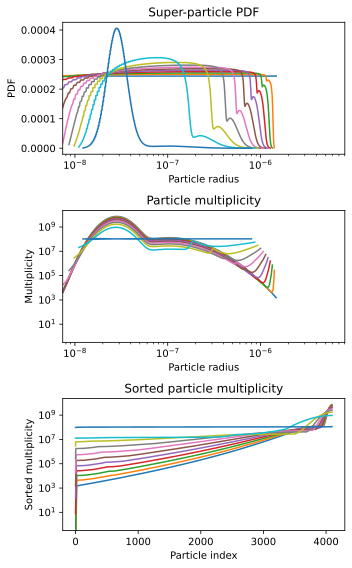

In [74]:
def plot_mult_spread(particles, params_phys, params_comp, params_bins, rng):
    fig, axs = pyplot.subplot_mosaic(
        [['PDF'],['Multiplicity'],['Sorted Multiplicity']],
        figsize=(5, 8),
        tight_layout=True,
    )
    for k in particles:
        if 'sd_pdf' not in particles[k]:
            continue
        axs['PDF'].plot(
            x_of_mass(particles[k]['mass']),
            particles[k]['sd_pdf'],
            label=k,
        )
        axs['PDF'].set(
            ylabel='PDF',
            title='Super-particle PDF',
            xlabel='Particle radius',
            xscale='log',
            xlim=(params_bins.min_x, params_bins.max_x),
        )
        axs['Multiplicity'].plot(
            x_of_mass(particles[k]['mass']),
            particles[k]['mult'],
        )
        axs['Multiplicity'].set(
            ylabel='Multiplicity',
            title='Particle multiplicity',
            xlabel='Particle radius',
            xscale='log',
            yscale='log',
            xlim=(params_bins.min_x, params_bins.max_x),

        )

        axs['Sorted Multiplicity'].plot(
            np.sort(particles[k]['mult']),
        )
        axs['Sorted Multiplicity'].set(
            ylabel='Sorted multiplicity',
            title='Sorted particle multiplicity',
            xlabel='Particle index',
            yscale='log',
        )
    show_plot()


plot_mult_spread(
    particles=PARTICLES,
    params_phys=PARAMS_PHYS,
    params_comp=PARAMS_COMP,
    params_bins=PARAMS_BINS,
    rng=RNG
)